# Forming and Interpretation of an Interferogram

In the previous notebooks, we discussed about SAR images with a major focus on the amplitude of the backscatter (amount of return signal). In this notebook, we will focus on describing InSAR (Interferometric Synthetic Aperture Radar), a radar technique able to process the phase information.

InSAR employs phase information in two SAR photos to determine the phase difference between each pair of associated image points, resulting in an interferogram. The phase difference of two images taken from the same viewpoint, but at different times, can precisely measure any shifts of the returned phase. Thus, if the Earth’s surface moved toward or away from the radar between the two imaging passes, phase changes would result that can be measured with a precision corresponding to millimeter-level displacements (Bürgmann et al., 2000). Moreover, InSAR can be also used to retrieve the surface topography at the resolution of the SAR image.

In this notebook, we will see how to form a SAR interferogram starting from two Interferometric Wide (IW) swath mode Sentinel-1 radar acquisitions (imaging the same area with 12 days temporal gap) bracketing the magnitude 7.8 2023 Turkey–Syria earthquake and exposing the impressing co-seismic ground deformations. For the sake of simplicity, we will plot the result of only 1 swath.

In [1]:
import xarray as xr
import dask.array as da
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import rasterio
from rasterio.plot import show, plotting_extent
import folium
from matplotlib.colors import Normalize
import rioxarray


In [2]:
folder_path = Path('~/shared/datasets/rs/datapool/mrs/Unit3-sentinel1_interferogram').expanduser()
measurement_folder = "1_SLC_S1_images/S1A_IW_SLC__1SDV_20230129T033452_20230129T033519_046993_05A2FE_BE0B.SAFE/measurement"

In [3]:
vv_tiff_files = [
    "s1a-iw1-slc-vv-20230129t033452-20230129t033517-046993-05a2fe-004.tiff",
    "s1a-iw2-slc-vv-20230129t033453-20230129t033518-046993-05a2fe-005.tiff",
    "s1a-iw3-slc-vv-20230129t033454-20230129t033519-046993-05a2fe-006.tiff"
]

vv_tiff_paths = [folder_path / measurement_folder / file for file in vv_tiff_files]


Lets see how dataset looks like:

In [4]:
chunks = {'band': 1, 'x': 3000, 'y': 3000}

datacube1 = rioxarray.open_rasterio(vv_tiff_paths[2])# chunks=chunks)
datacube1.chunk({'y': 3000, 'x': 3000})


<xarray.DataArray (band: 1, y: 13680, x: 25133)> Size: 3GB
dask.array<xarray-<this-array>, shape=(1, 13680, 25133), dtype=complex64, chunksize=(1, 3000, 3000), chunktype=numpy.ndarray>
Coordinates:
  * band         (band) int64 8B 1
    spatial_ref  int64 8B 0
Dimensions without coordinates: y, x
Attributes:
    AREA_OR_POINT:             Area
    TIFFTAG_DATETIME:          2023:01:29 06:30:01
    TIFFTAG_IMAGEDESCRIPTION:  Sentinel-1A IW SLC L1
    TIFFTAG_SOFTWARE:          Sentinel-1 IPF 003.52
    scale_factor:              1.0
    add_offset:                0.0

As it is quite large, for plotting purpose lets downsample it, by averaging data. The assumption is that there is good enough autocorrelation between pixels, or in other words we do not expect amplitude values "jump" from one pixel to another.

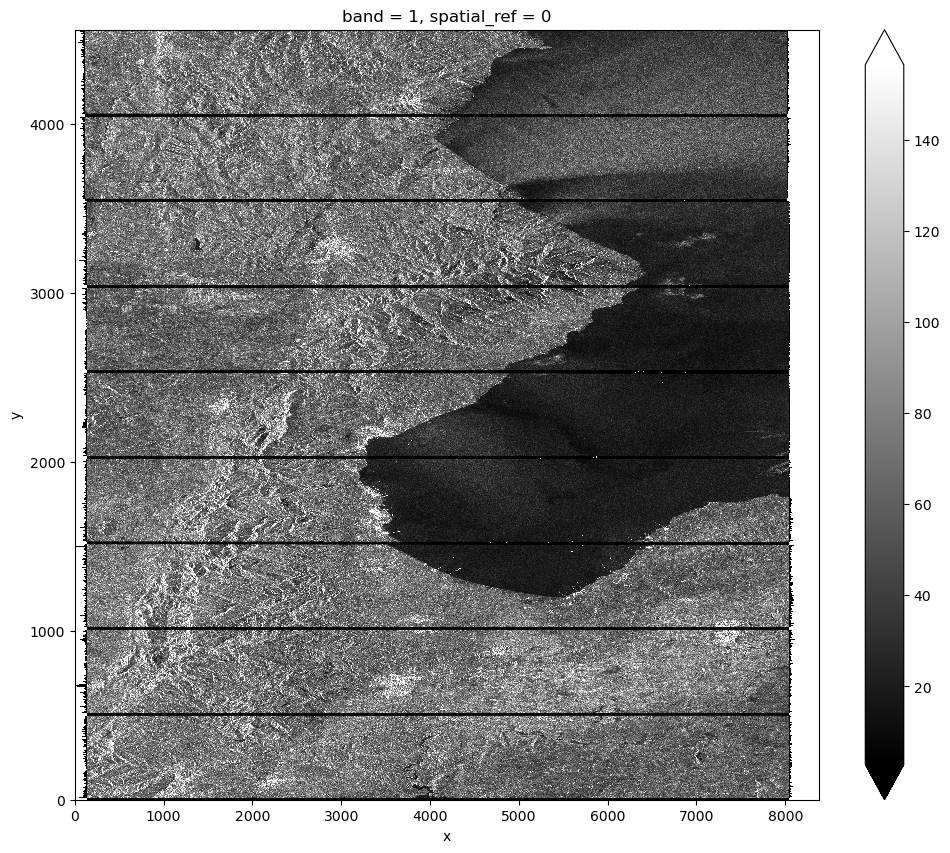

In [5]:
amplitude = xr.apply_ufunc(abs, datacube1.isel(band=0))
downsampled_amplitude = amplitude.coarsen(x=3, y=3, boundary='pad').mean()

amplitude = downsampled_amplitude.where(downsampled_amplitude != 0)

plt.figure(figsize=(12, 10))
plt.title("Single Look Complex - Amplitude")
amplitude.plot(cmap='gray',robust=True)

However, we do not expect autocorrelation between pixels with phase value.

$$
\varphi = -\frac{2\pi}{\lambda}\cdot2R + \varphi_{\text{scatt}} - n \cdot 2\pi
$$

Phase measurement is sensitive to range $R$ change in order of magnitude of wavelength, so few centimeters. Therefore, even a slight change inside one pixel, which could be from 1 to 100 metre wide, will lead to phase change but in wrapped interval from $0$ to $2\pi$ (*). That combined with random nature of speckle noise, atmospheric influences and the very nature of phase in sense of destructive or constructive interference leads to inability to do simple averaging. So, with that in mind, we will plot large dataset by simply "skipping" pixels, or plotting every pixel at stepsize difference.

(*) Keep in mind that in the previous equation the number of full phases $n$, between satellite and ground target, is unknown! Also known as phase ambiguity.

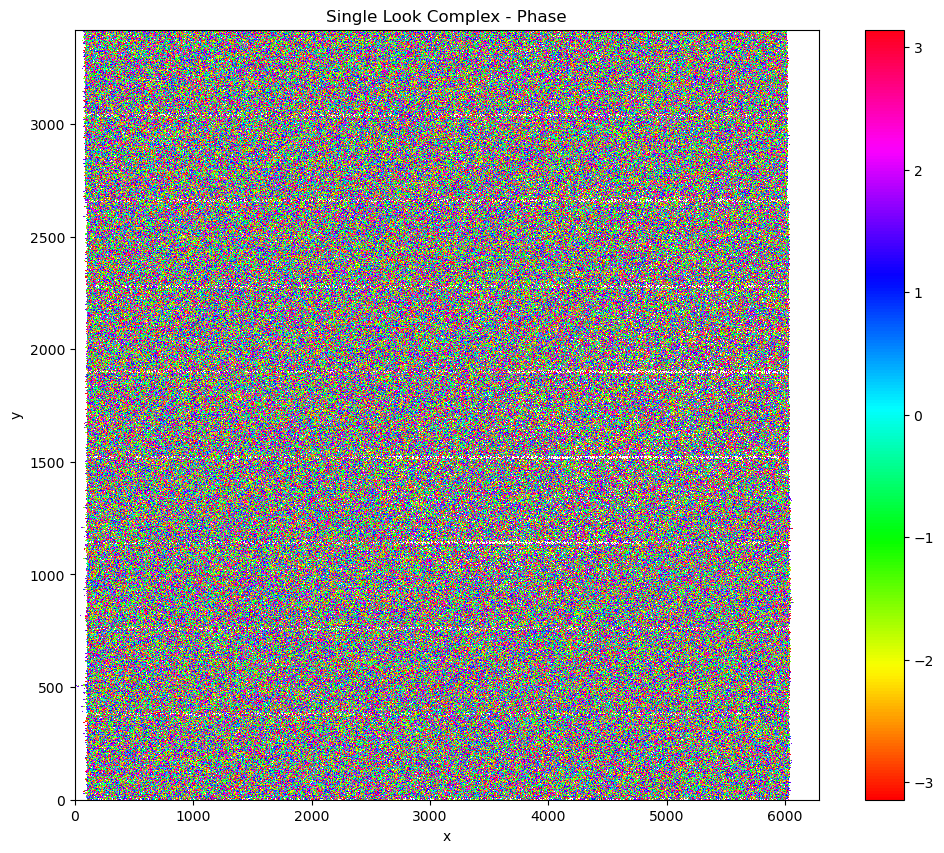

In [6]:
phase = xr.apply_ufunc(np.angle, datacube1.isel(band=0))

step = 4

downsampled_phase = phase.isel(
    x=slice(0, None, step),
    y=slice(0, None, step)
)

phase = downsampled_phase.where(downsampled_phase != 0)

plt.figure(figsize=(12, 10))
phase.plot(cmap='hsv')
plt.title("Single Look Complex - Phase")
plt.show()

For now, phase information looks uninterpretable, but it will be shown later in the notebook how useful it is in geosciences.

Now, lets load the already processed steps results.

In [7]:
tif_files = list(folder_path.rglob("**/*.tif"))

for i, file in enumerate(tif_files):
    print(i, ':',file)

0 : /home/ljovic/shared/datasets/rs/datapool/mrs/Unit3-sentinel1_interferogram/7_geocoding/S1A_IW_SLC__1SDV_20230129T033452_20230129T033519_046993_05A2FE_BE0B_Orb_Stack_IW3_ifg_deb_dinsar_ML_flt_TC_Cnv.tif
1 : /home/ljovic/shared/datasets/rs/datapool/mrs/Unit3-sentinel1_interferogram/5_topographic_phase_removal/S1A_IW_SLC__1SDV_20230129T033452_20230129T033519_046993_05A2FE_BE0B_Orb_Stack_IW3_ifg_deb_dinsar_Cnv.tif
2 : /home/ljovic/shared/datasets/rs/datapool/mrs/Unit3-sentinel1_interferogram/6_multilooking_and_filtering/S1A_IW_SLC__1SDV_20230129T033452_20230129T033519_046993_05A2FE_BE0B_Orb_Stack_IW3_ifg_deb_dinsar_ML_flt_Cnv.tif
3 : /home/ljovic/shared/datasets/rs/datapool/mrs/Unit3-sentinel1_interferogram/2_coregistered_images_IW3/S1A_IW_SLC__1SDV_20230129T033452_20230129T033519_046993_05A2FE_BE0B_Orb_Stack_IW3_Cnv.tif
4 : /home/ljovic/shared/datasets/rs/datapool/mrs/Unit3-sentinel1_interferogram/3_interferogram_and_coherence_formation/S1A_IW_SLC__1SDV_20230129T033452_20230129T033519

## 2) Coregistering images

In this case, two SAR images over southeast Turkey were taken on two different dates, 29th January and 10th February of 2023. For that reason, to analyze measurement differences in this period, it is necessary to georeference pixels on their exact position on Earth and also to coregister two images, so each pixel can align. One scatterer on the ground (trees, fences, cars, etc.) is physically smaller than ground pixel size (from 1 to 100 meters). A small change in range distance (distance from satellite to the ground target) corresponds to phase measurement difference in the following way

$$\Delta R = \frac{\lambda}{2} \frac{\Delta \varphi}{2\pi}$$

So SAR is quite sensitive to slight changes and therefore sub-pixel accuracy is necessary for this kind of analysis. That being said, pixels of two images should aligned as accurate as possible.

**IMAGE 1**

Knowing all that, lets load the data into xarray dataset.

In [8]:
chunks = {'band': 1, 'x': 3000, 'y': 3000}

datacube1 = rioxarray.open_rasterio(tif_files[3])# chunks=chunks)

band_labels = ["Intensity_IW3_VH_mst_29Jan2023",
               "Intensity_IW3_VV_mst_29Jan2023",
               "Intensity_IW3_VH_slv1_10Feb2023",
               "Intensity_IW3_VV_slv1_10Feb2023"]

datacube1 = datacube1.assign_coords(band=("band", band_labels))
datacube1


Warning 1: TIFFFetchNormalTag:Incorrect count for "GeoTiePoints"; tag ignored
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
/home/ljovic/.local/lib/python3.10/site-packages/rioxarray/_io.py:1136: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))  # type: ignore


<xarray.DataArray (band: 4, y: 13680, x: 25133)> Size: 6GB
[1375277760 values with dtype=float32]
Coordinates:
  * x            (x) float64 201kB 3.082e-05 9.247e-05 0.0001541 ... 1.549 1.549
  * y            (y) float64 109kB -5.188e-05 -0.0001556 ... -1.419 -1.419
    spatial_ref  int64 8B 0
  * band         (band) <U31 496B 'Intensity_IW3_VH_mst_29Jan2023' ... 'Inten...
Attributes:
    AREA_OR_POINT:           Area
    TIFFTAG_RESOLUTIONUNIT:  1 (unitless)
    TIFFTAG_XRESOLUTION:     1
    TIFFTAG_YRESOLUTION:     1
    scale_factor:            1.0
    add_offset:              0.0

Lets plot intensity of SAR measurements on 29th January and 10th February 2023, in VH and VV polarisations. Also, note that intensity is square of amplitude
$$
I = A^2
$$
so some features on the image will be more prominent and amplified.


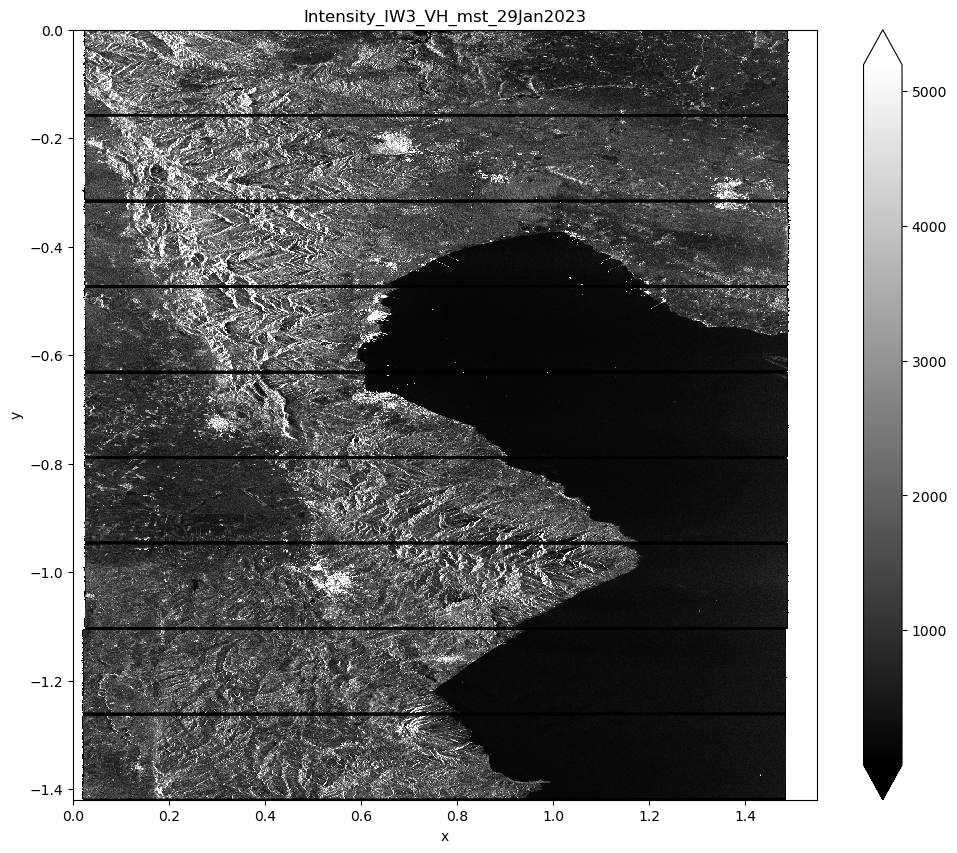

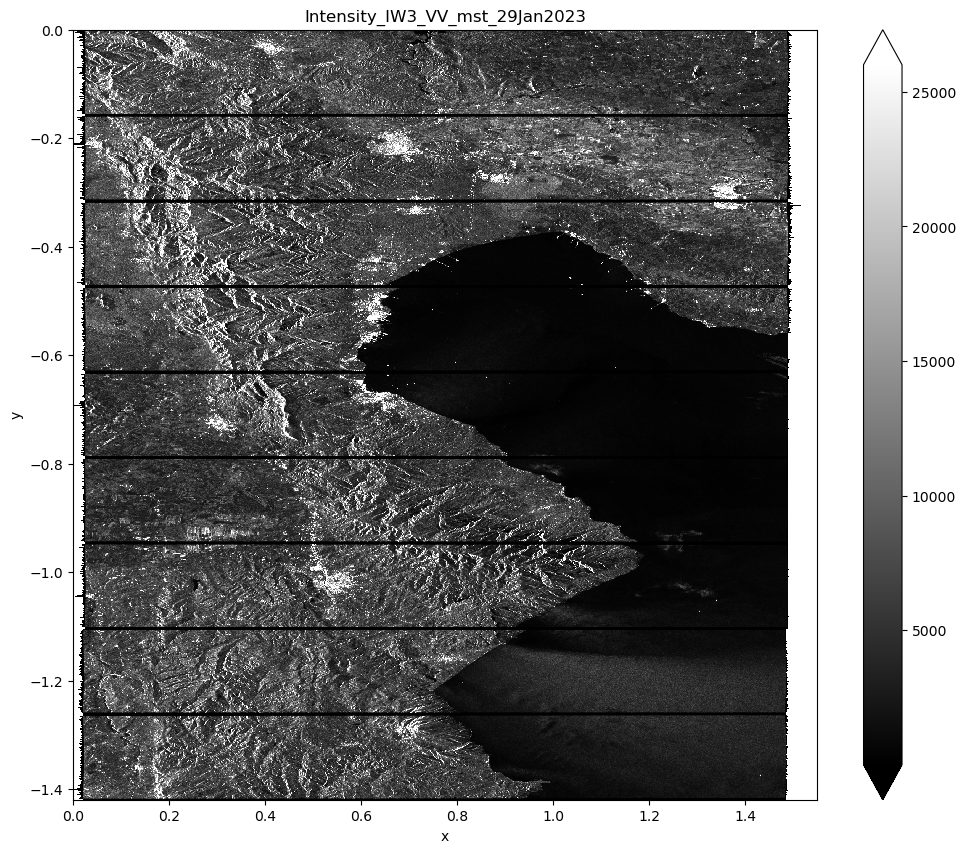

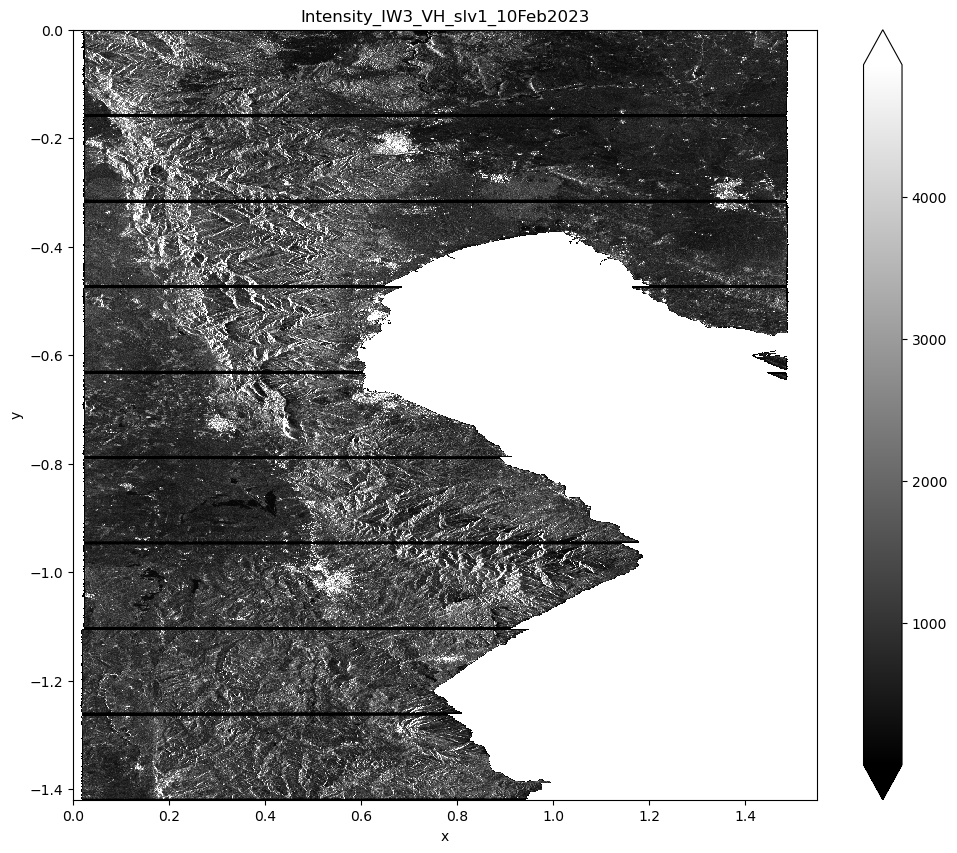

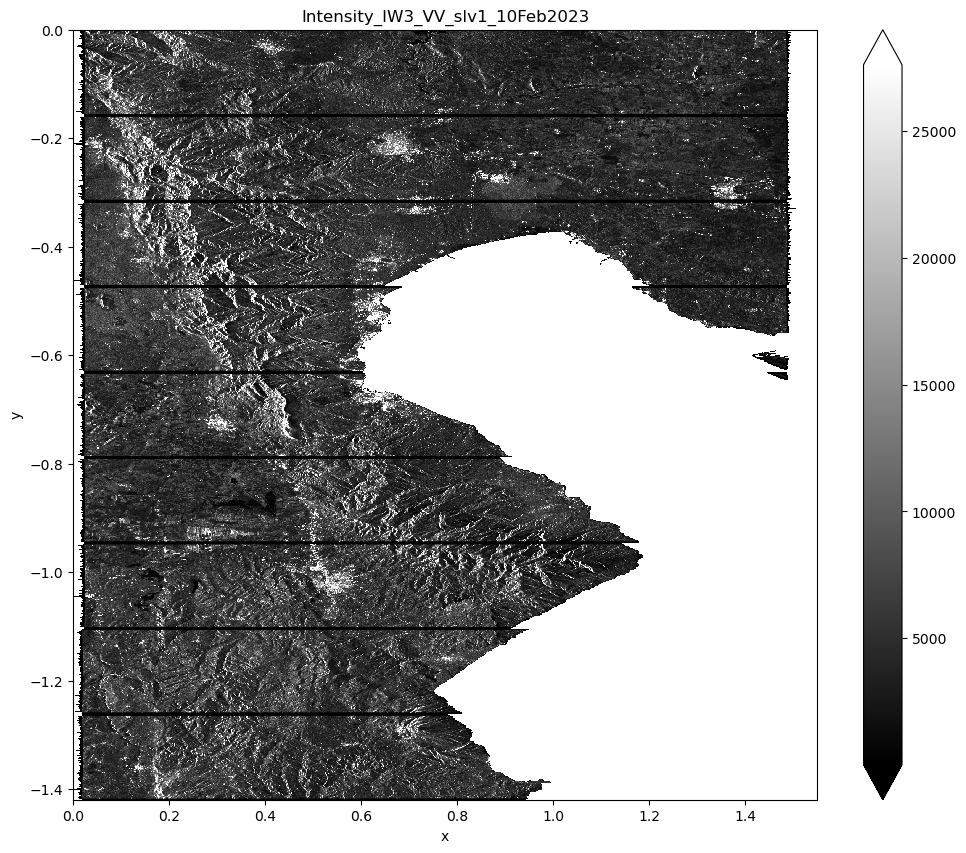

In [9]:
# 29th January VH
band = 0
downsampled_data = datacube1.isel(band=band).coarsen(x=10, y=10, boundary='pad').mean()
data = downsampled_data.where(downsampled_data != 0)

plt.figure(figsize=(12, 10))
data.plot(cmap='gray',robust=True)
plt.title(datacube1.band.values[band])
plt.show()

# 29th January VV
band = 1
downsampled_data = datacube1.isel(band=band).coarsen(x=10, y=10, boundary='pad').mean()
data = downsampled_data.where(downsampled_data != 0)

plt.figure(figsize=(12, 10))
data.plot(cmap='gray',robust=True)
plt.title(datacube1.band.values[band])
plt.show()

# 10th February VH
band = 2
downsampled_data = datacube1.isel(band=band).coarsen(x=10, y=10, boundary='pad').mean()
data = downsampled_data.where(downsampled_data != 0)

plt.figure(figsize=(12, 10))
data.plot(cmap='gray',robust=True)
plt.title(datacube1.band.values[band])
plt.show()

# 10th February VV
band = 3
downsampled_data = datacube1.isel(band=band).coarsen(x=10, y=10, boundary='pad').mean()
data = downsampled_data.where(downsampled_data != 0)

plt.figure(figsize=(12, 10))
data.plot(cmap='gray',robust=True)
plt.title(datacube1.band.values[band])
plt.show()

#plt.figure(figsize=(12, 10))
#(10 * np.log10(data)).plot(cmap='gray',robust=True)

## 3) Formation of interferogram and coherence

The interferogram is formed by cross-multiplying the master image (acquisition of the 29th January) with the complex conjugate of the “slave" image (acquisition of the 10th January). The amplitude of both images is multiplied while their respective phases are differenced to form the interferogram.

In [10]:
chunks = {'band': 1, 'x': 5000, 'y': 5000}

datacube1 = rioxarray.open_rasterio(tif_files[4], chunks=chunks)
band_labels = ["Phase_ifg_IW3_VH_29Jan2023_10Feb2023",
               "coh_IW3_VH_29Jan2023_10Feb2023",
               "Phase_ifg_IW3_VV_29Jan2023_10Feb2023",
               "coh_IW3_VV_29Jan2023_10Feb2023"]

datacube1 = datacube1.assign_coords(band=("band", band_labels))
datacube1


/home/ljovic/.local/lib/python3.10/site-packages/rioxarray/_io.py:1136: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))  # type: ignore
Warning 1: TIFFFetchNormalTag:Incorrect count for "GeoTiePoints"; tag ignored
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


<xarray.DataArray (band: 4, y: 13680, x: 25133)> Size: 6GB
dask.array<open_rasterio-027062acd300e07a9652508c8786613f<this-array>, shape=(4, 13680, 25133), dtype=float32, chunksize=(1, 5000, 5000), chunktype=numpy.ndarray>
Coordinates:
  * x            (x) float64 201kB 3.082e-05 9.247e-05 0.0001541 ... 1.549 1.549
  * y            (y) float64 109kB -5.188e-05 -0.0001556 ... -1.419 -1.419
    spatial_ref  int64 8B 0
  * band         (band) <U36 576B 'Phase_ifg_IW3_VH_29Jan2023_10Feb2023' ... ...
Attributes:
    AREA_OR_POINT:           Area
    TIFFTAG_RESOLUTIONUNIT:  1 (unitless)
    TIFFTAG_XRESOLUTION:     1
    TIFFTAG_YRESOLUTION:     1
    scale_factor:            1.0
    add_offset:              0.0

In [11]:
datacube1.isel(band=0)

<xarray.DataArray (y: 13680, x: 25133)> Size: 1GB
dask.array<getitem, shape=(13680, 25133), dtype=float32, chunksize=(5000, 5000), chunktype=numpy.ndarray>
Coordinates:
  * x            (x) float64 201kB 3.082e-05 9.247e-05 0.0001541 ... 1.549 1.549
  * y            (y) float64 109kB -5.188e-05 -0.0001556 ... -1.419 -1.419
    spatial_ref  int64 8B 0
    band         <U36 144B 'Phase_ifg_IW3_VH_29Jan2023_10Feb2023'
Attributes:
    AREA_OR_POINT:           Area
    TIFFTAG_RESOLUTIONUNIT:  1 (unitless)
    TIFFTAG_XRESOLUTION:     1
    TIFFTAG_YRESOLUTION:     1
    scale_factor:            1.0
    add_offset:              0.0

The data is large, so downsampling or selecting a smaller area is necessary. While it's generally fine to downsample scalar values like amplitude, which are spatially autocorrelated, phase behaves differently. Amplitude changes between pixels are often noise, so averaging can help reducing noise. However, phase averaging can cause coherence loss due to destructive interference, losing important sub-pixel variations. This is why Single Look Complex data is needed. To preserve phase information, we'll skip pixels instead of averaging. For example, with step = 2, every second pixel is plotted.

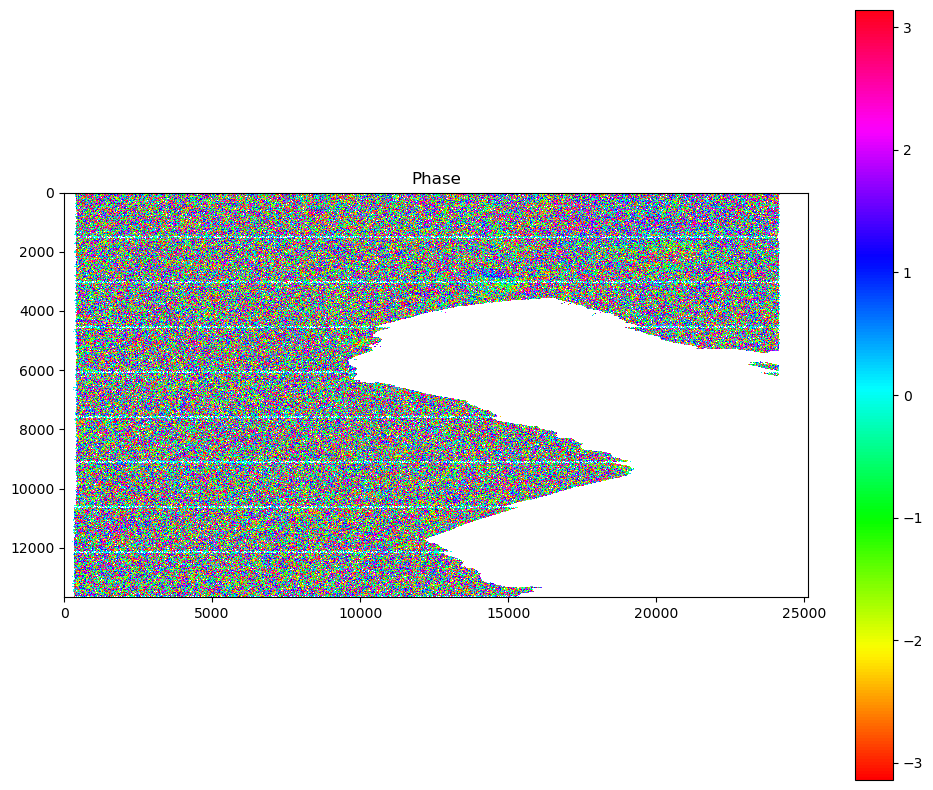

In [12]:
data_plot = datacube1.isel(band=0).where(datacube1.isel(band=2) !=0, np.nan)
#data_plot = datacube1.isel(band=0)
#data_plot = datacube1.isel(band=0, x=slice(0, 5000), y=slice(0, 5000))

plt.figure(figsize=(12, 10))

#plt.imshow(datacube1.isel(band=0), cmap='hsv')
plt.imshow(data_plot, cmap='hsv', resample = True, interpolation='none').axes.set_aspect('equal')
plt.colorbar()
plt.title('Phase')
plt.show()

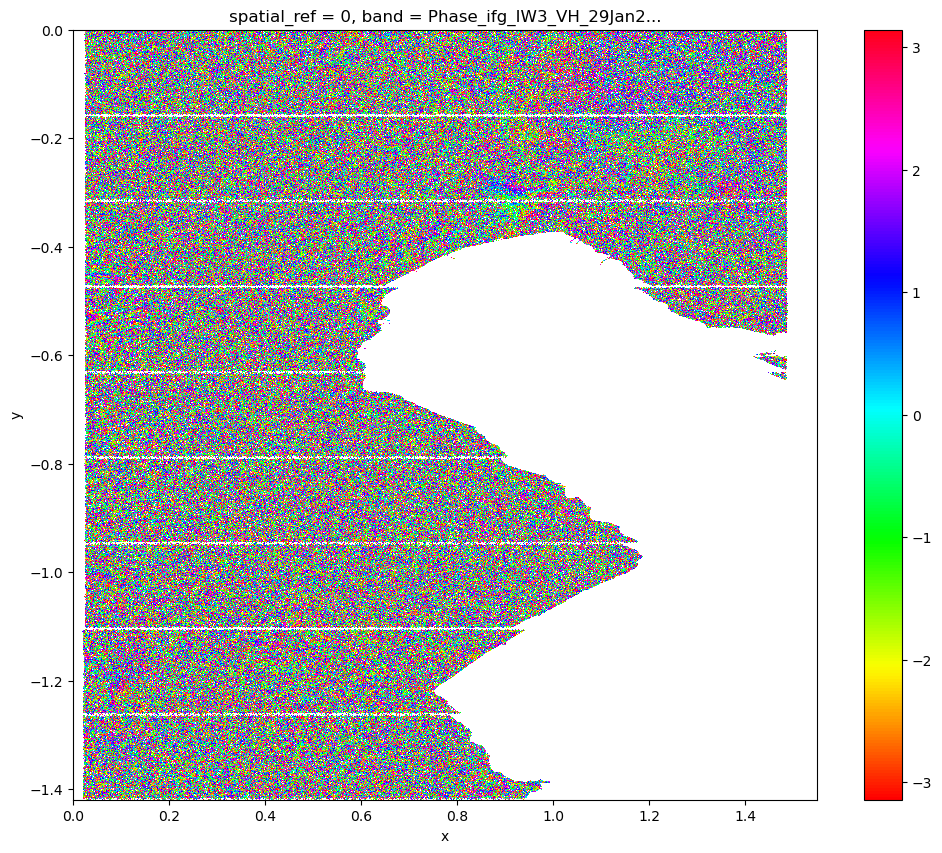

In [13]:
step = 2

downsampled_data = datacube1.isel(band=0).isel(
    x=slice(0, None, step),
    y=slice(0, None, step)
)

downsampled_data = downsampled_data.where(downsampled_data != 0)

plt.figure(figsize=(12, 10))
downsampled_data.plot(cmap='hsv')
plt.show()

Already some features (fringes) are visible, so lets zoom on them.

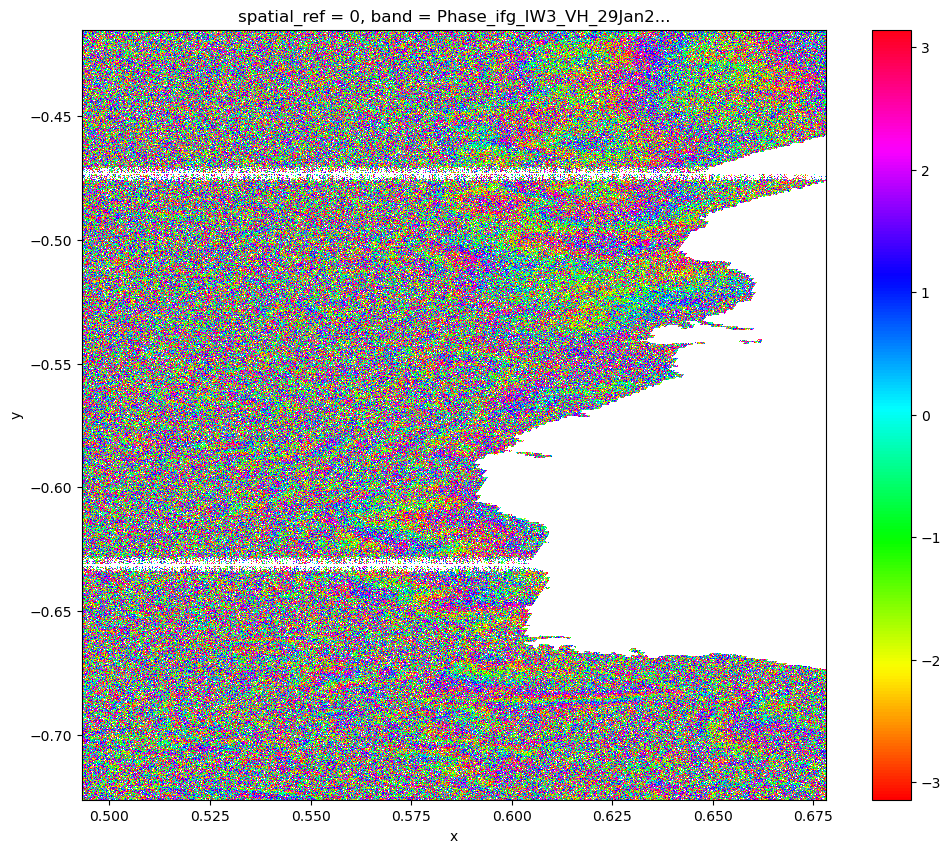

In [14]:
step = 1

downsampled_data = datacube1.isel(band=0).isel(
    x=slice(8000, 11000, step),
    y=slice(4000, 7000, step)
)

downsampled_data = downsampled_data.where(downsampled_data != 0)

plt.figure(figsize=(12, 10))
downsampled_data.plot(cmap='hsv')
plt.show()

As mentioned before, neighboring pixels would not be so autocorrelated, however measurement of perfectly coregistered pixel from different satellites or from different time will in fact lead to similar phase value, if there was not drastic change of area (earthquake, forest cut down, etc.). So after forming interferogram, we will see actual noise between acquisitions, so now futher processing has to be done to have a meaningful information for interpretation.

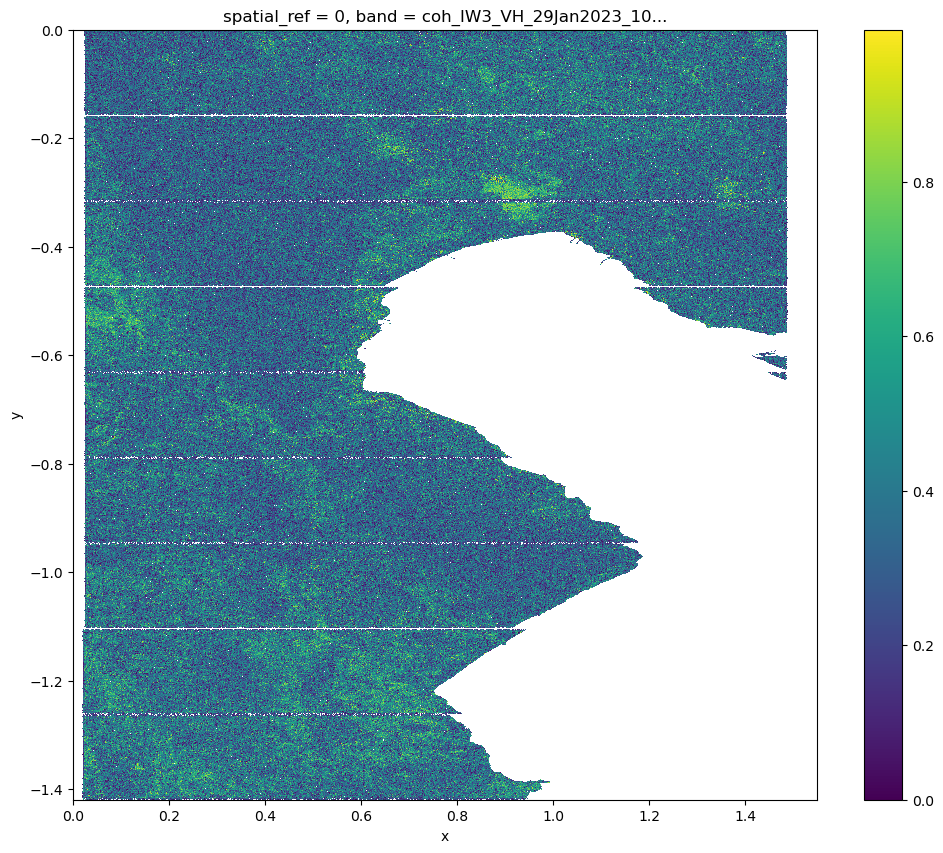

In [15]:
step = 2

downsampled_data = datacube1.isel(band=1).isel(
    x=slice(0, None, step),
    y=slice(0, None, step)
)

downsampled_data = downsampled_data.where(downsampled_data != 0)

plt.figure(figsize=(12, 10))
downsampled_data.plot(cmap='viridis')
plt.show()

## 4) Debursting images

Now, as side-looking SAR Sentinel-1 is sending and receiving signals as swadth over wide areas, there will be those demarcation lines between them. To seamlessly join all Sentinel-1 bursts (divided by the visible demarcation lines) into a single image, we will apply the so-called debursting operation.

In this case we have Interferometric Wide (IW) Swath Mode, so there are different bursts that can be combined.

/home/ljovic/.local/lib/python3.10/site-packages/rioxarray/_io.py:1136: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))  # type: ignore
Warning 1: TIFFFetchNormalTag:Incorrect count for "GeoTiePoints"; tag ignored
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


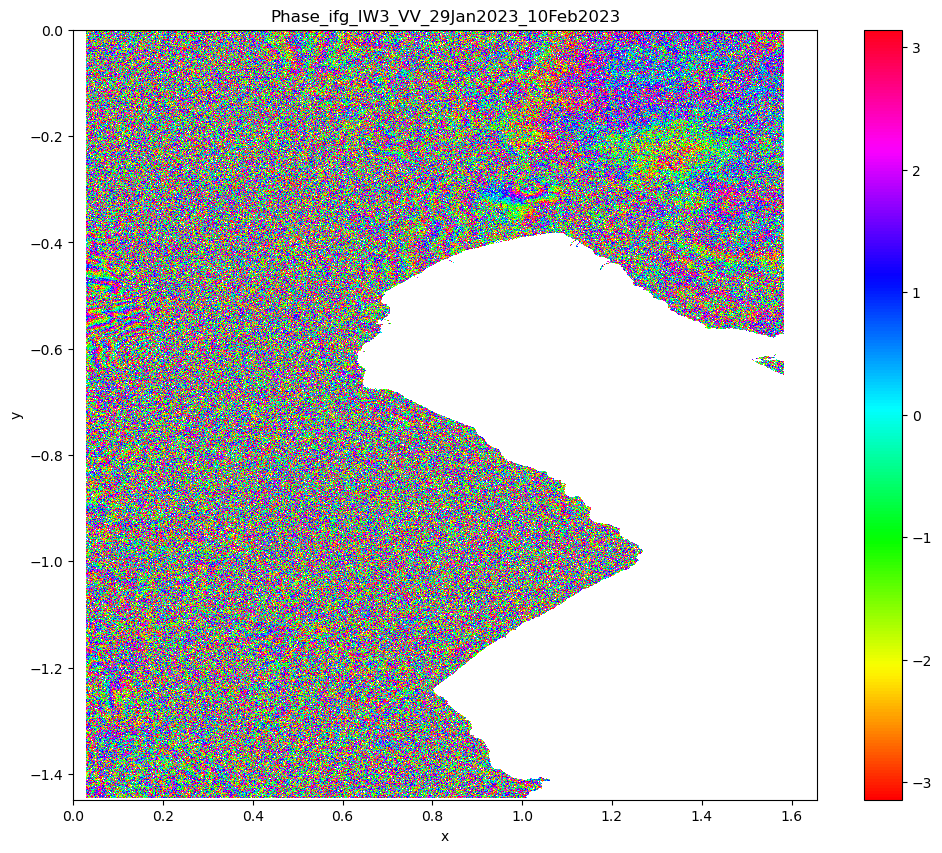

In [16]:
chunks = {'band': 1, 'x': 3000, 'y': 3000}

datacube1 = rioxarray.open_rasterio(tif_files[5])# chunks=chunks)

band_labels = ["Phase_ifg_IW3_VV_29Jan2023_10Feb2023",
               "coh_IW3_VV_29Jan2023_10Feb2023"]

datacube1 = datacube1.assign_coords(band=("band", band_labels))

selected_band = 0

step = 3

downsampled_data = datacube1.isel(band=selected_band).isel(
    x=slice(0, None, step),
    y=slice(0, None, step)
)

downsampled_data = downsampled_data.where(downsampled_data != 0)

plt.figure(figsize=(12, 10))
downsampled_data.plot(cmap='hsv')
plt.title(datacube1.band.values[selected_band])
plt.show()


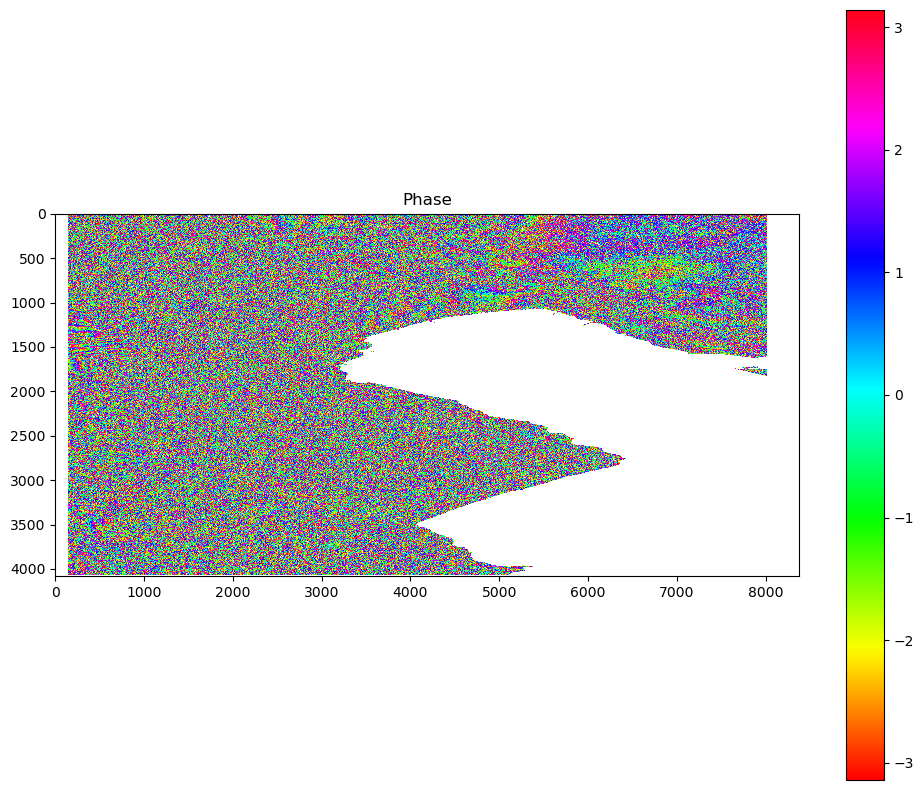

In [17]:
data = downsampled_data.where(downsampled_data != 0)

plt.figure(figsize=(12, 10))
plt.imshow(data, cmap='hsv', resample = True, interpolation='none')
plt.colorbar()
plt.title('Phase')
plt.show()
#data.plot(cmap='hsv',robust=True)

## 5) Removal of topographic phase

The phase difference in interferogram is a total information that contains deformation of ground and information on topography, among other influences. If we want to detect ground motion over time, topographic phase has to be removed. Topographic phase contributions are typically removed using a reference DEM (Copernicus DEM 30m), which is subtracted from the interferogram.

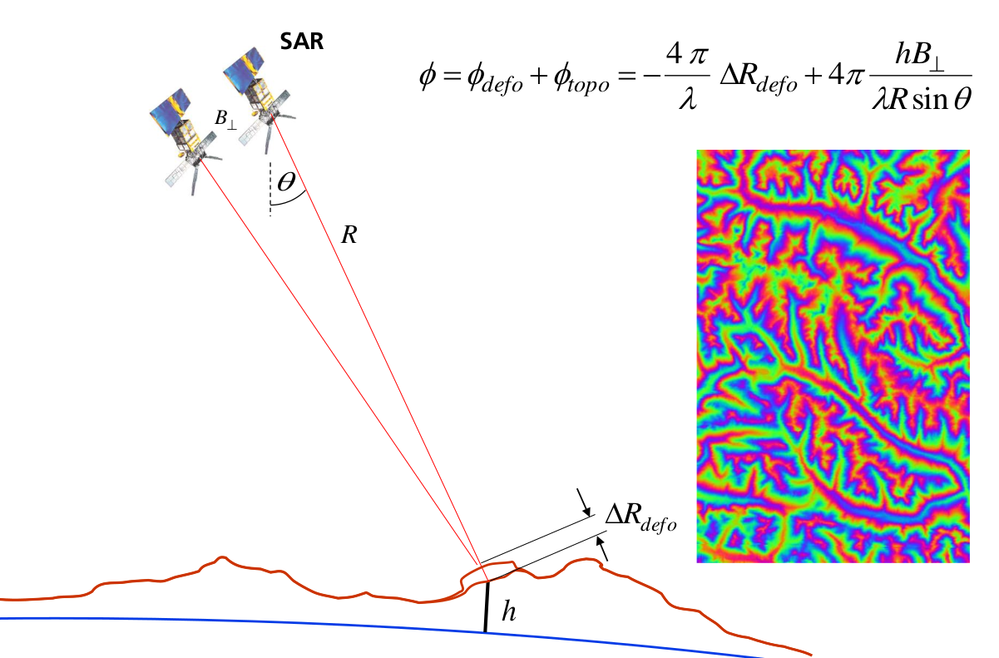

In [18]:
datacube1 = rioxarray.open_rasterio(tif_files[1])
band_labels = ["Phase_ifg_srd_IW3_VV_29Jan2023_10Feb2023",
               "coh_IW3_VV_29Jan2023_10Feb2023"]
datacube1 = datacube1.assign_coords(band=("band", band_labels))

step = 2

downsampled_data = datacube1.isel(band=0,
                                  x=slice(0, None, step),
                                  y=slice(0, None, step)
                                  )

downsampled_data = downsampled_data.where(downsampled_data != 0).compute()
downsampled_data.chunk({'y': 1000, 'x': 1000})


/home/ljovic/.local/lib/python3.10/site-packages/rioxarray/_io.py:1136: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))  # type: ignore
Warning 1: TIFFFetchNormalTag:Incorrect count for "GeoTiePoints"; tag ignored
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


<xarray.DataArray (y: 6125, x: 12566)> Size: 308MB
dask.array<xarray-<this-array>, shape=(6125, 12566), dtype=float32, chunksize=(1000, 1000), chunktype=numpy.ndarray>
Coordinates:
  * x            (x) float64 101kB 3.296e-05 0.0001648 0.0002966 ... 1.656 1.656
  * y            (y) float64 49kB -5.912e-05 -0.0002956 ... -1.448 -1.448
    spatial_ref  int64 8B 0
    band         <U40 160B 'Phase_ifg_srd_IW3_VV_29Jan2023_10Feb2023'
Attributes:
    AREA_OR_POINT:           Area
    TIFFTAG_RESOLUTIONUNIT:  1 (unitless)
    TIFFTAG_XRESOLUTION:     1
    TIFFTAG_YRESOLUTION:     1
    scale_factor:            1.0
    add_offset:              0.0

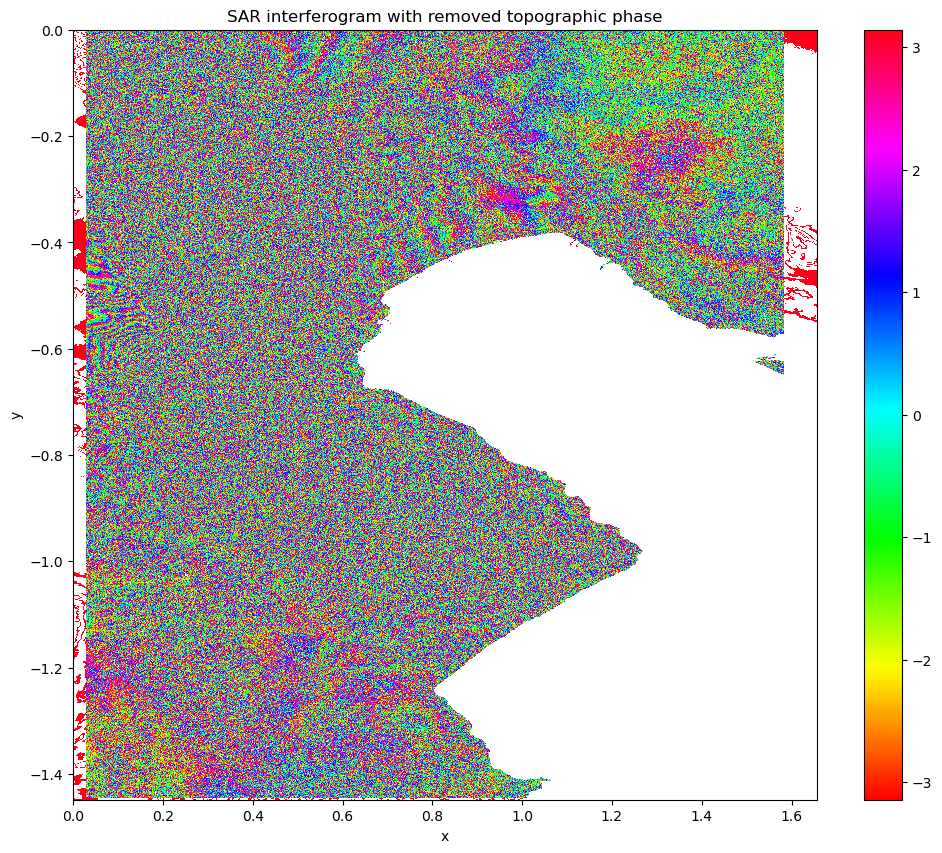

In [19]:
plt.figure(figsize=(12, 10))
downsampled_data.plot(cmap='hsv')
plt.title("SAR interferogram with removed topographic phase")
plt.show()

Lets compare some region where topographic removal is visible:

/home/ljovic/.local/lib/python3.10/site-packages/rioxarray/_io.py:1136: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))  # type: ignore
Warning 1: TIFFFetchNormalTag:Incorrect count for "GeoTiePoints"; tag ignored
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
/home/ljovic/.local/lib/python3.10/site-packages/rioxarray/_io.py:1136: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))  # type: ignore
Warning 1: TIFFFetchNormalTag:Incorrect count for "GeoTiePoints"; tag ignored
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color chan

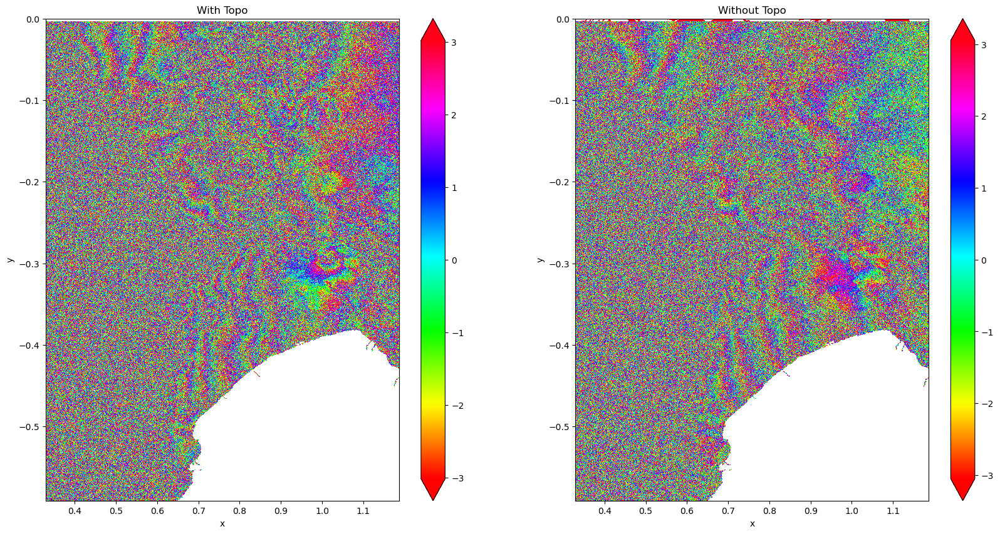

In [20]:
step = 2
xmin = 5000
xmax =  18_000
ymin =  0
ymax = 5000

dc_with_topo = rioxarray.open_rasterio(tif_files[5])

downsampled_data_with_topo = dc_with_topo.isel(band=0,
                                  x=slice(xmin, xmax, step),
                                  y=slice(ymin, ymax, step)
                                  )

downsampled_data_with_topo = downsampled_data_with_topo.where(downsampled_data_with_topo != 0).compute()


dc_without_topo = rioxarray.open_rasterio(tif_files[1])

downsampled_data_without_topo = dc_without_topo.isel(band=0,
                                  x=slice(xmin, xmax, step),
                                  y=slice(ymin, ymax, step)
                                  )

downsampled_data_without_topo = downsampled_data_without_topo.where(downsampled_data_without_topo != 0).compute()

fig, axs = plt.subplots(1, 2, figsize=(20, 10))
downsampled_data_with_topo.plot(ax=axs[0], cmap='hsv', robust=True)
axs[0].set_title("With Topo")

downsampled_data_without_topo.plot(ax=axs[1], cmap='hsv', robust=True)
axs[1].set_title("Without Topo")
plt.show()

## 6) Multilooking and filtering

During the interferogram formation, we have to keep in mind that the phase information incur in degradation due to noisy factors that are inherently present. Phase signal decorrelation between two images can be temporal (during the 12 days period between the two SAR acquisitions ground conditions may have changed, such as moisture content and vegetation growth), geometric (difference in the incidence angles between the two acquisitions) or due to volume scattering (multiple scattering of a radar signal within a medium) and processing errors. All these process are summed up in the coherence information.

Coherence is generated during the interferogram and is used to test the validity of the derived phase data. It is a measure of the similarity between two SAR images or the consistency of the phase information between different looks (or acquisitions). It ranges from 0 (no coherence, meaning highly noisy data) to 1 (perfect coherence, meaning reliable phase information). Being γ coherence, it is constituted by several terms:

$$
\gamma_{\text{total}} = \gamma_{\text{temporal}} \cdot \gamma_{\text{geometric}} \cdot \gamma_{\text{volumetric}} \cdot \gamma_{\text{processing}} \cdot \gamma_{\text{noise}}
$$

To be able to properly analyze the phase signatures in the interferogram (increase the signal-to-noise ratio), we need to apply multi-looking and phase filtering techniques. For this operations, the coherence information is crucial.

- Multi-looking computes the spatial average of a specified number of neighboring pixels (in this instance, 6×2 pixels).
- Goldstein Phase Filtering is a low-pass filter used to suppress high-frequency noise.


/home/ljovic/.local/lib/python3.10/site-packages/rioxarray/_io.py:1136: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))  # type: ignore
Warning 1: TIFFFetchNormalTag:Incorrect count for "GeoTiePoints"; tag ignored


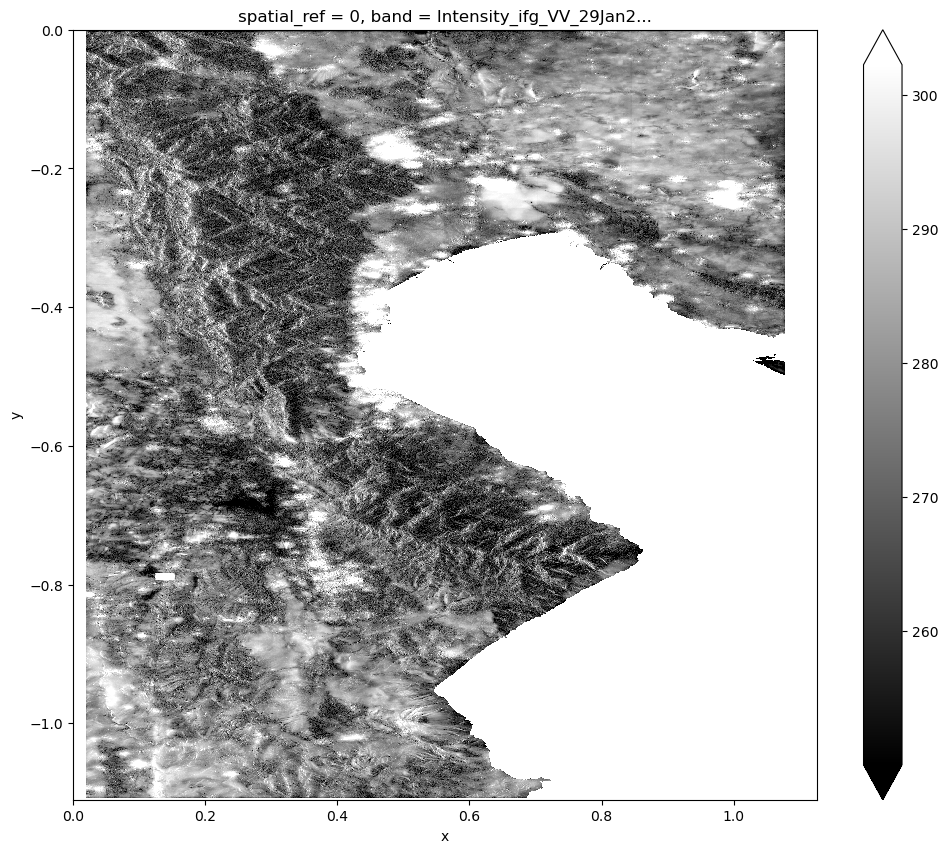

In [21]:
chunks = {'band': 1, 'x': 3000, 'y': 3000}

datacube1 = rioxarray.open_rasterio(tif_files[2])# chunks=chunks)
band_labels = ["Intensity_ifg_VV_29Jan2023_10Feb2023",
               "Phase_ifg_VV_29Jan2023_10Feb2023",
               "coh_IW3_VV_29Jan2023_10Feb2023"]

datacube1 = datacube1.assign_coords(band=("band", band_labels))

data = datacube1.isel(band=0).where(datacube1.isel(band=0) != 0)

plt.figure(figsize=(12, 10))
data.plot(cmap='gray', robust=True)

/home/ljovic/.local/lib/python3.10/site-packages/rioxarray/_io.py:1136: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))  # type: ignore
Warning 1: TIFFFetchNormalTag:Incorrect count for "GeoTiePoints"; tag ignored


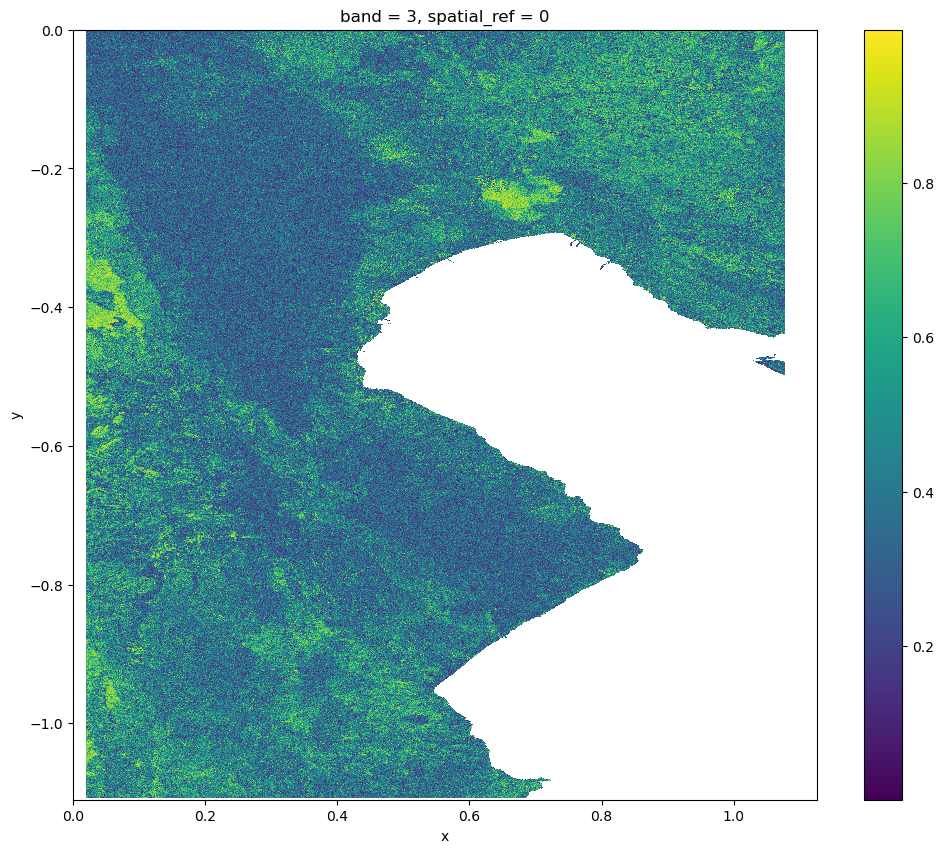

In [22]:
chunks = {'band': 1, 'x': 3000, 'y': 3000}

datacube1 = rioxarray.open_rasterio(tif_files[2])# chunks=chunks)

data = datacube1.isel(band=2).where(datacube1.isel(band=2) != 0)

plt.figure(figsize=(12, 10))
data.plot(cmap='viridis')

/home/ljovic/.local/lib/python3.10/site-packages/rioxarray/_io.py:1136: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))  # type: ignore
Warning 1: TIFFFetchNormalTag:Incorrect count for "GeoTiePoints"; tag ignored


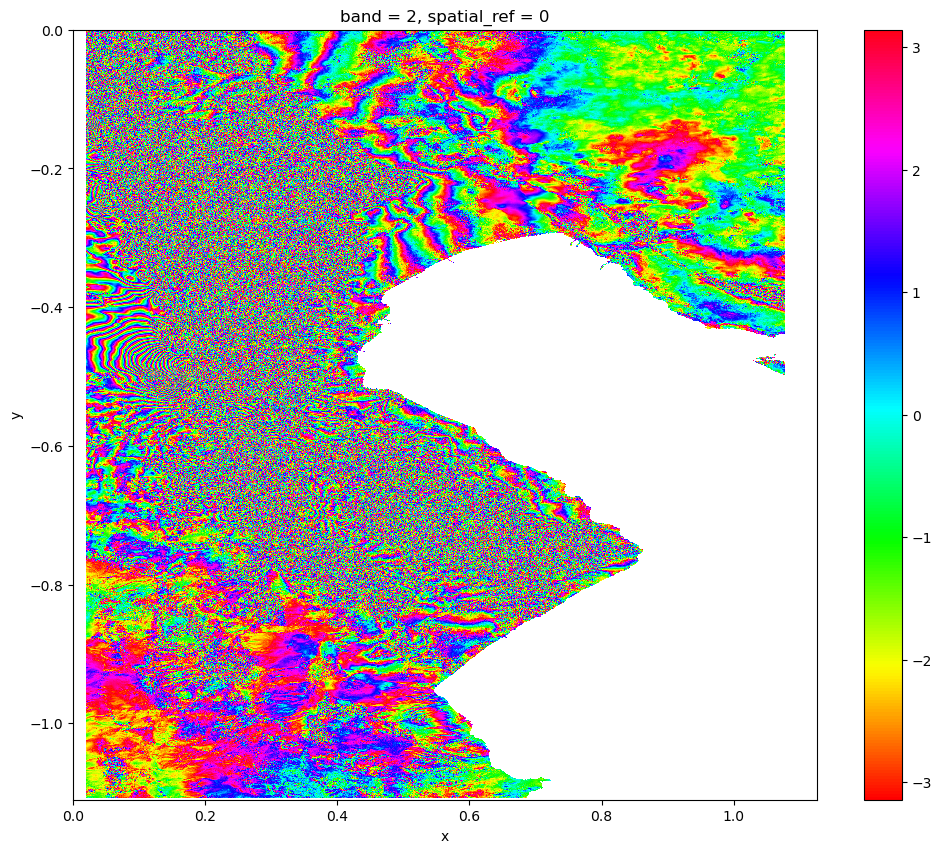

In [23]:
chunks = {'band': 1, 'x': 3000, 'y': 3000}

datacube1 = rioxarray.open_rasterio(tif_files[2])# chunks=chunks)

data = datacube1.isel(band=1).where(datacube1.isel(band=1) != 0)

plt.figure(figsize=(12, 10))
data.plot(cmap='hsv')

#### 7) Geocoding

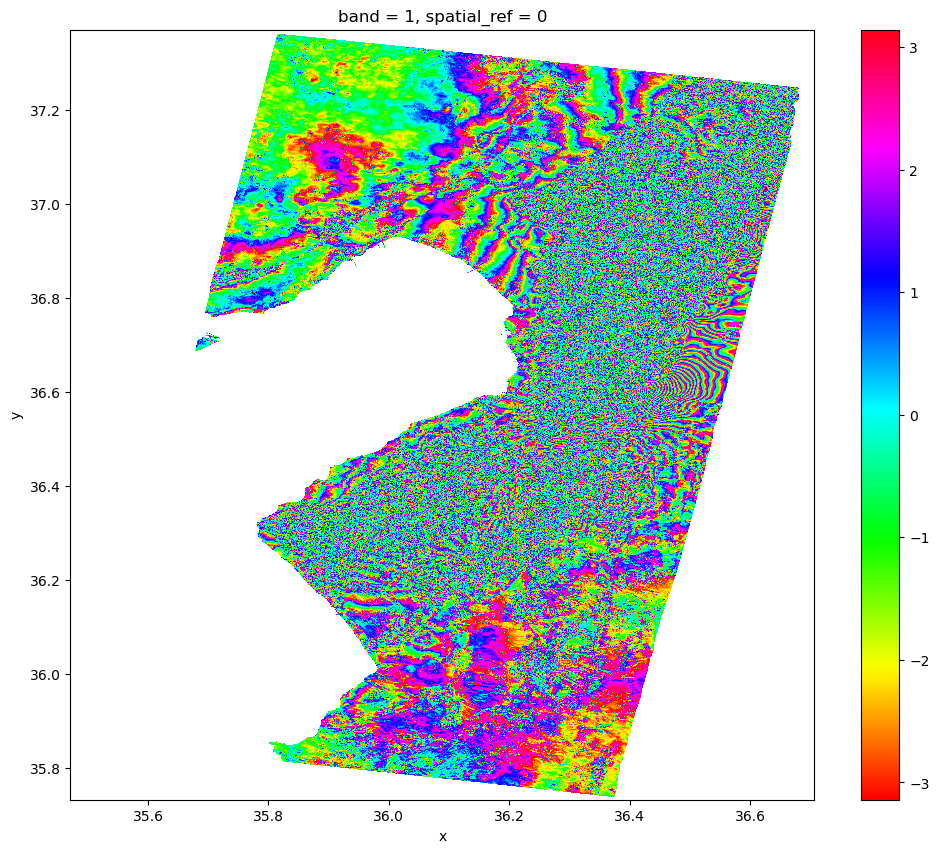

In [24]:
chunks = {'band': 1, 'x': 3000, 'y': 3000}

datacube1 = rioxarray.open_rasterio(tif_files[0])# chunks=chunks)

data = datacube1.where(datacube1 != 0).squeeze('band')

plt.figure(figsize=(12, 10))
data.plot(cmap='hsv')

After geocoding the image is adjusted to the WGS84 projection. The wrapped interferogram carries a range of information about surface deformation (strength and direction of motion) and the location of the surface rupture.

Each fringe corresponds to a full 2π phase change, representing a change in the path length difference between the two SAR acquisitions. Tight fringes (closely spaced) indicate rapid phase changes, Wide fringes (spaced farther apart) indicate gentle phase changes.

In [25]:
normed_data = Normalize(vmin=np.nanmin(data.values), vmax=np.nanmax(data.values))(data.values)

cmap = plt.get_cmap('hsv')
rgba_img = cmap(normed_data.filled(np.nan))  # Convert masked array to regular array with NaNs
print("Shape before squeezing:", rgba_img.shape)

rgb_img = (rgba_img[:, :, :3] * 255).astype(np.uint8)  # Convert RGBA to RGB by stripping the alpha channel
print("Shape after slicing to RGB:", rgb_img.shape)


Shape before squeezing: (6079, 4586, 4)
Shape after slicing to RGB: (6079, 4586, 3)



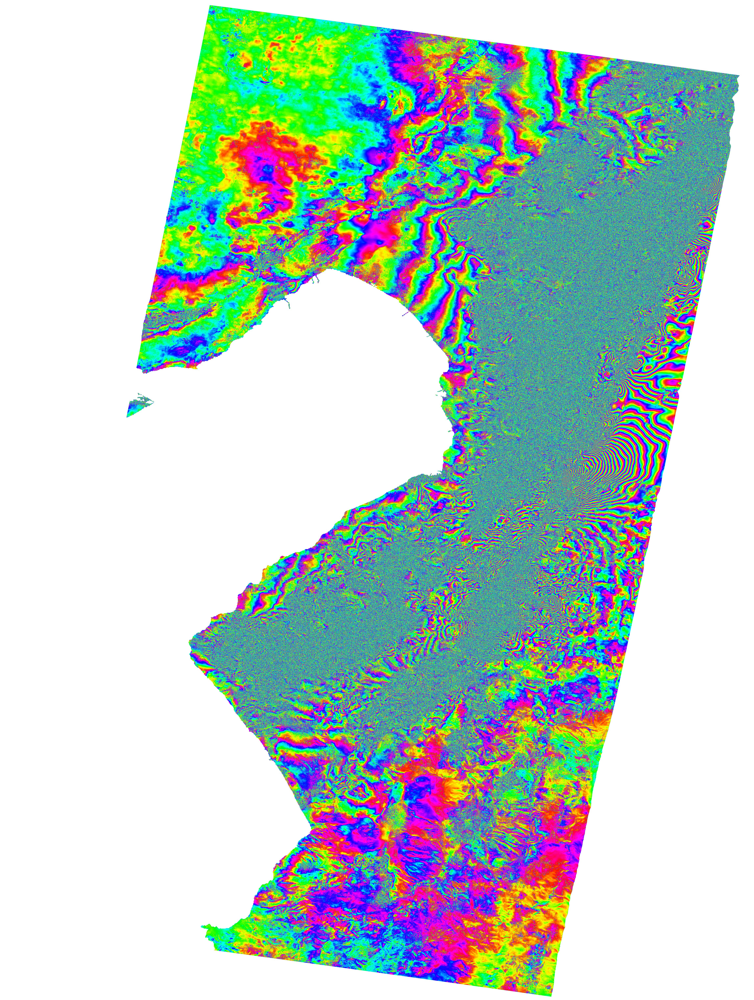

In [26]:
bounds = datacube1.rio.bounds()
left, bottom, right, top = bounds
center = [(top + bottom) / 2, (left + right) / 2]

m = folium.Map(location=center, zoom_start=10)

folium.raster_layers.ImageOverlay(
    image=rgba_img,
    bounds=[[bottom, left], [top, right]],
    origin='upper',
    opacity=0.5,
    interactive=True,
    cross_origin=False
).add_to(m)

m